# Gan-control: inference examples
This notbook shows explicit and implicit control examples using the Controller class.

In [1]:
import os
import torch
from PIL import Image
import pandas as pd
import sys

sys.path.append('../src')  # insert the path to src here


c:\Users\user\anaconda3\envs\dog-breeds-classification\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Load controller

In [2]:
!git clone "https://github.com/amazon-science/gan-control"

Cloning into 'gan-control'...


In [ ]:
from google.colab import drive
drive.mount('/content/drive')
!ls '/content/drive/MyDrive'



Mounted at /content/drive
 09C6E0DF-A09E-4B80-99D0-840A84EF699E.png
 0E784040-A5C5-49A6-A71E-90343FB6621D.png
 10FBC4D3-ABBB-480E-8B5D-87EF46838309.png
'1 (1).jpg'
 165930630_511532960013154_5216094688815731182_n.jpg
 1_fix.jpg
 1.jpg
 1.txt
'2 (1).jpg'
 234355172_366707361673633_1062548857349543541_n.jpg
 234773654_272771667644695_895539783598268271_n.jpg
 240446213_811898756165714_1391188953328551200_n.jpg
 2910C5A4-7E54-4513-B0F4-FAA32FC13DE6.png
 2BEC75D6-A15F-43B5-8633-43D3B29F31AF.png
 2FE829A0-6FA5-40C9-8A89-5010F2D78F6B.png
'2_filter_tables (1).PNG'
 2_filter_tables.PNG
 2_icmp_ping.PNG
 2_imunes_and_icmp.PNG
 2.jpg
 2_UDP_and_Ping.PNG
 2_UPD_and_Ping.PNG
 31_filter_tables.PNG
 31_imunes_and_icmp.PNG
'3 (1).jpg'
 31_UDP_and_Ping.PNG
 3.jpg
 437969D6-DD71-442F-85F4-BBF560FF04F8.jpeg
 48023834-91A6-4EA8-9F68-73596F8B6876.png
 4E30F2B3-ABD1-43C1-89DA-0803AD53C285.png
 4.pdf
'4th year schedule.gsheet'
 588B4F20-795A-4C08-91CD-2AA708942272.png
 6222781179_5bitsDiv.PNG
 6222781179-5b

In [2]:
%cd ./gan-control/src
from gan_control.inference.controller import Controller
controller_path = '../resources/gan_models/controller_age015id025exp02hai04ori02gam15' #../../drive/MyDrive/controller_age015id025exp02hai04ori02gam15
controller = Controller(controller_path)

c:\Users\user\Desktop\Work\4th Year 1st Half\Deep Learning\CSS485_GAN\gan-control\src


INFO:gan_control.inference.controller: Init Controller class...
INFO:gan_control.inference.inference: Init inference class...
INFO:gan_control.inference.inference: Retrieve config from ../resources/gan_models/controller_age015id025exp02hai04ori02gam15\generator\args.json
INFO:gan_control.inference.inference: Init Batch Utils...
INFO:gan_control.utils.mini_batch_multi_split_utils: MiniBatchUtils parameters:
mini batch size 16
total batch size 16
sub group names ['id', 'expression', 'orientation', 'gamma', 'age', 'hair', 'other']
0) id: place in mini batch: [0, 4] place in latent: [0, 128]
1) expression: place in mini batch: [4, 6] place in latent: [128, 192]
2) orientation: place in mini batch: [6, 8] place in latent: [192, 256]
3) gamma: place in mini batch: [8, 10] place in latent: [256, 320]
4) age: place in mini batch: [10, 12] place in latent: [320, 384]
5) hair: place in mini batch: [12, 14] place in latent: [384, 448]
6) other: place in mini batch: [14, 16] place in latent: [448,

# Section 1: Explicit control

## Generate random faces and save latents

INFO:gan_control.inference.inference: Calc mean_w_latents...


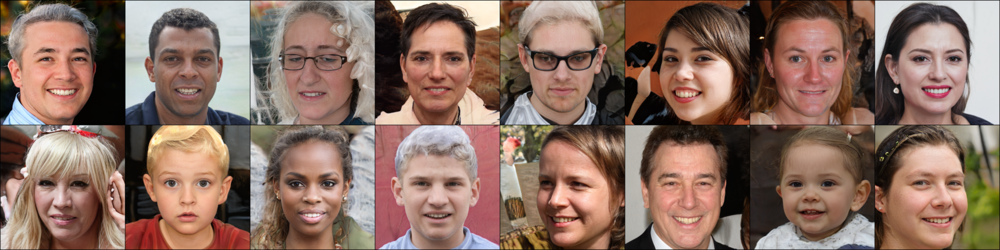

In [3]:
batch_size = 16
truncation = 0.7
resize = 480
initial_image_tensors, initial_latent_z, initial_latent_w = controller.gen_batch(batch_size=batch_size, truncation=truncation)
controller.make_resized_grid_image(initial_image_tensors, resize=resize, nrow=8)

## Control pose
Control parameter: Euler angles (yaw, pitch, roll)

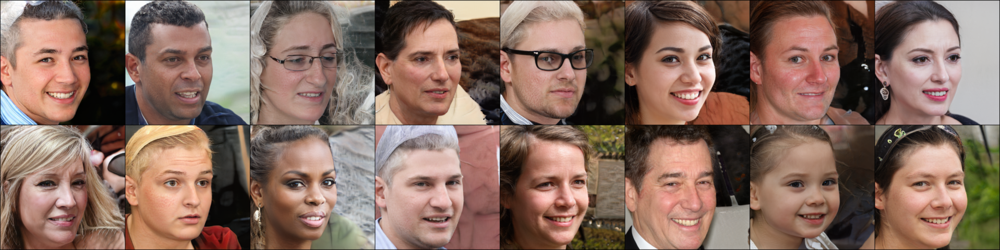

In [4]:
# yaw=30, pitch=-10, roll=0
pose_control = torch.tensor([[-30., -10., 0.]])
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=initial_latent_w, input_is_latent=True, orientation=pose_control)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

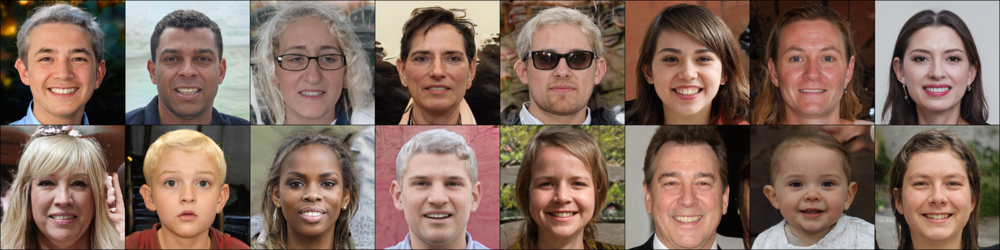

In [5]:
# face the front: yaw=0, pitch=0, roll=0
pose_control = torch.tensor([[0., 0., 0.]])
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, orientation=pose_control)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

## Control age
Control parameter: Age (scalar)

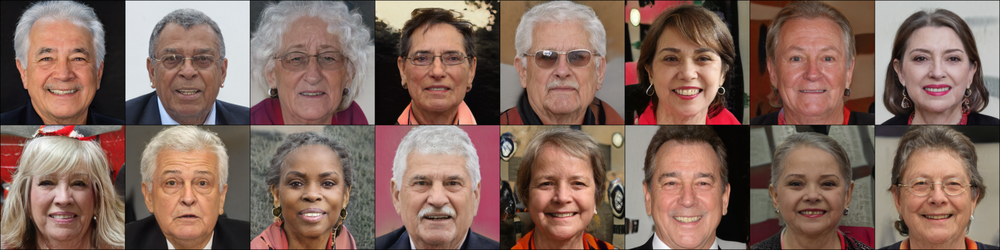

In [6]:
# age = 75
age_control = torch.tensor([[75.]])
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, age=age_control)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

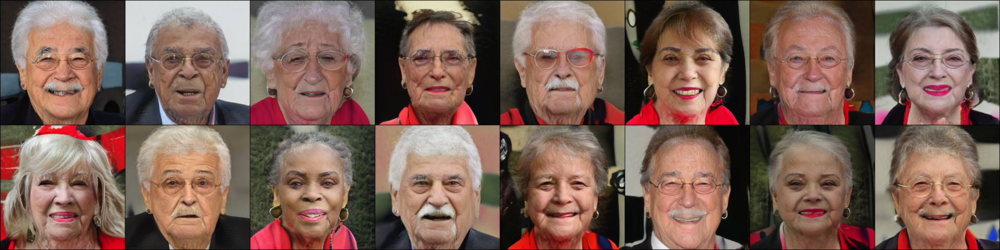

In [7]:
# age = 30
age_control = torch.tensor([[100.]])
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, age=age_control)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

## Control hair color
Control parameter: RGB hair color (R, G, B)

In [8]:
bloand_color = torch.tensor([[0.73 , 0.62 , 0.36]])
black_color = torch.tensor([[0.08 , 0.08 , 0.08]])

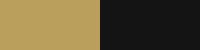

In [9]:
def get_concat_h(im1, im2):
    dst = Image.new('RGB', (im1.width + im2.width, im1.height))
    dst.paste(im1, (0, 0))
    dst.paste(im2, (im1.width, 0))
    return dst

bloand_img = Image.new('RGB', (100, 50), tuple((bloand_color * 255).int().tolist()[0]))
black_img = Image.new('RGB', (100, 50), tuple((black_color * 255).int().tolist()[0]))
get_concat_h(bloand_img, black_img)

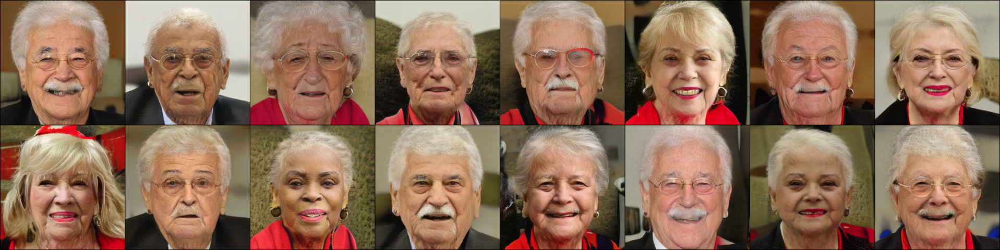

In [10]:
# blond
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, hair=bloand_color)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

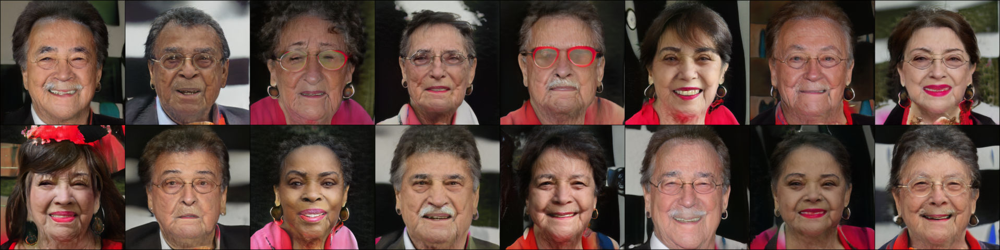

In [11]:
# black
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, hair=black_color)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

## Control illumination
Control parameter: Spherical harmonics vector (27 dimensions)

<ipython-input-19-d2c792ff5894>:4: UserWarning: Creating a tensor from a list of numpy.ndarrays is extremely slow. Please consider converting the list to a single numpy.ndarray with numpy.array() before converting to a tensor. (Triggered internally at ../torch/csrc/utils/tensor_new.cpp:230.)
  illumination_control = torch.tensor([sh_eval_basis_1(1, 0, 0)]) * strangth # calc spherical harmonics for right side illumination


tensor([[ 0.2821, -0.0000,  0.0000, -0.4886,  0.0000,  0.0000,  0.0000,  0.0000,
          0.0000,  0.2821, -0.0000,  0.0000, -0.4886,  0.0000,  0.0000,  0.0000,
          0.0000,  0.0000,  0.2821, -0.0000,  0.0000, -0.4886,  0.0000,  0.0000,
          0.0000,  0.0000,  0.0000]], dtype=torch.float64)


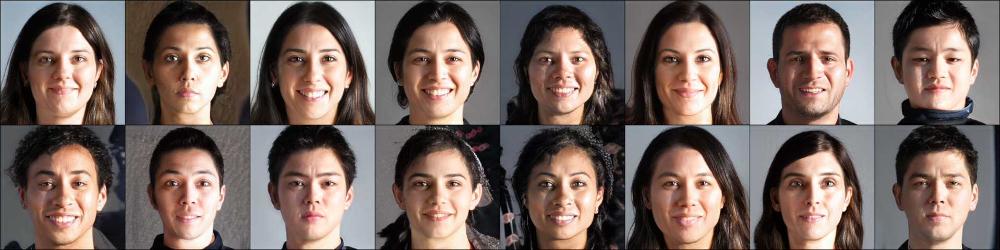

In [ ]:
from gan_control.utils.spherical_harmonics_utils import sh_eval_basis_1
# Right illumination
strangth = 1.
illumination_control = torch.tensor([sh_eval_basis_1(1, 0, 0)]) * strangth # calc spherical harmonics for right side illumination
print(illumination_control)
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, gamma=illumination_control)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

tensor([[0.2821, -0.0000, 0.4886, -0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.2821, -0.0000, 0.4886, -0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.2821, -0.0000, 0.4886, -0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000]],
       dtype=torch.float64)


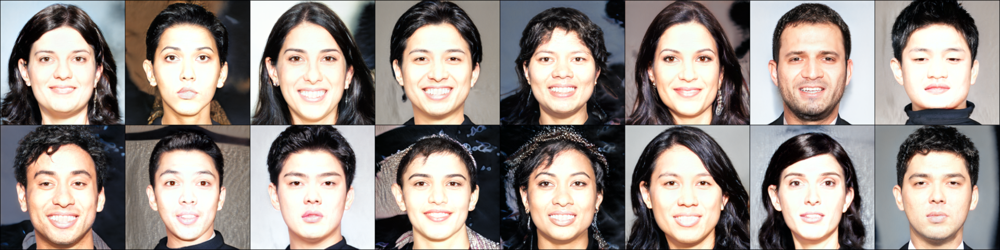

In [ ]:
# Strong front illumination
strangth = 1.
illumination_control = torch.tensor([sh_eval_basis_1(0, 0, 1)]) * strangth
print(illumination_control)
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, gamma=illumination_control)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

tensor([[0.1693, -0.0000, 0.2932, -0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.1693, -0.0000, 0.2932, -0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000,
         0.1693, -0.0000, 0.2932, -0.0000, 0.0000, 0.0000, 0.0000, 0.0000, 0.0000]],
       dtype=torch.float64)


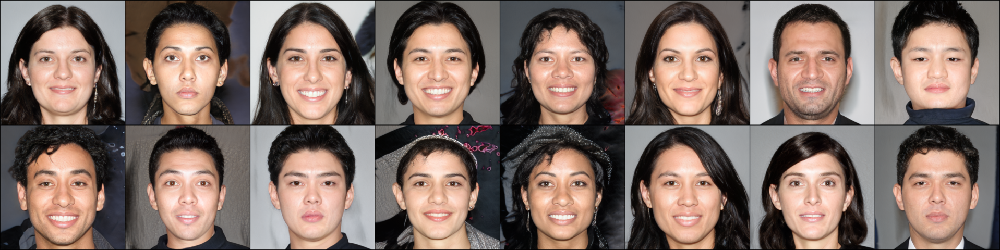

In [ ]:
# Weaker front illumination
strangth = 0.6
illumination_control = torch.tensor([sh_eval_basis_1(0, 0, 1)]) * strangth
print(illumination_control)
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, gamma=illumination_control)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

## Control expression
Control parameter: 3DMM beta paramter (64 dimensions)

In [ ]:
# Loading extracted attributes df
attributes_df = pd.read_pickle('../resources/ffhq_1K_attributes_samples_df.pkl')
expressions = attributes_df.expression3d.to_list()

# Some chosen expressions (most expression are smilles)
expression_0 = torch.tensor([expressions[2]])
expression_1 = torch.tensor([expressions[10]])
expression_2 = torch.tensor([expressions[16]])
expression_3 = torch.tensor([expressions[39]])


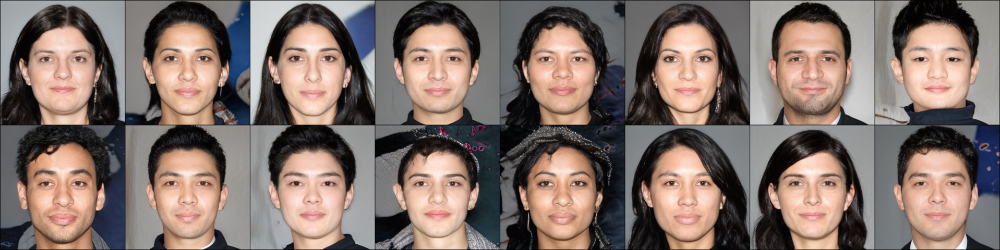

In [ ]:
# print(expression_0)
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, expression=expression_0)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

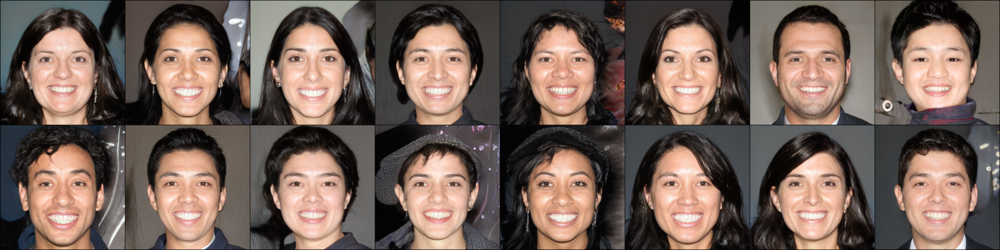

In [ ]:
# print(expression_1)
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, expression=expression_1)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

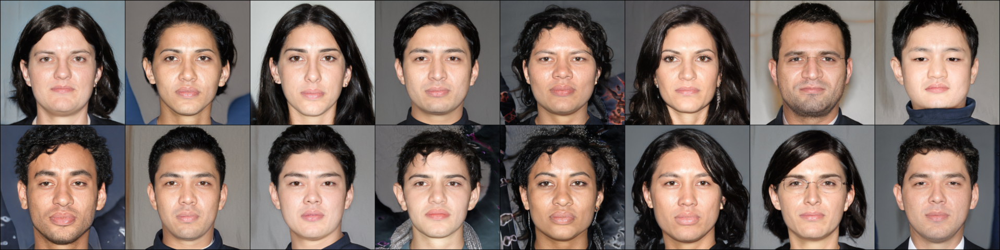

In [ ]:
# print(expression_2)
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, expression=expression_2)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

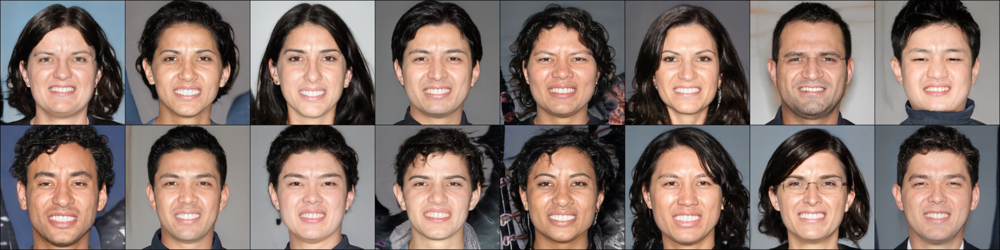

In [ ]:
# print(expression_3)
image_tensors, _, modified_latent_w = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True, expression=expression_3)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

# Section 2: Accessing and modifying the GAN's latent space

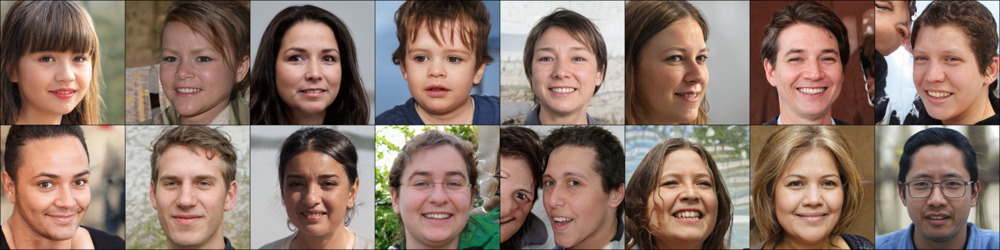

In [ ]:
# Generate new latents
image_tensors, _, source_latent_w = controller.gen_batch(batch_size=batch_size, truncation=truncation)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

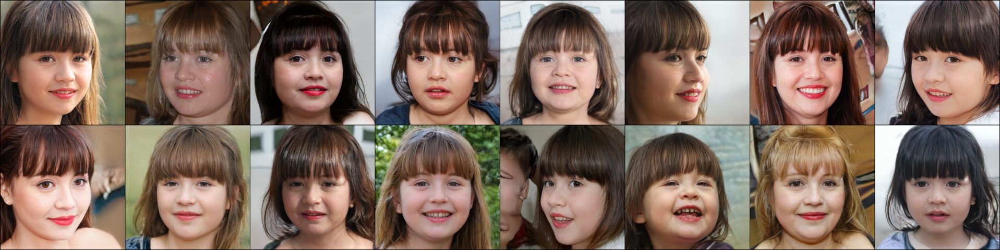

In [ ]:
# Set all IDs to image 0 ID
modified_latent_w = source_latent_w.clone()
id_w_latents = controller.get_group_w_latent(modified_latent_w, group='id')
id0_w_latent = id_w_latents[0]
modified_latent_w = controller.insert_group_w_latent(modified_latent_w, id0_w_latent, group='id')
image_tensors, _, _ = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

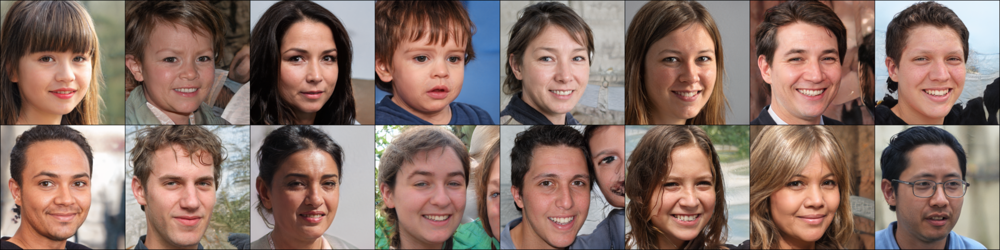

In [ ]:
# Set all poses to image 0 pose
modified_latent_w = source_latent_w.clone()
pose_w_latents = controller.get_group_w_latent(modified_latent_w, group='orientation')
pose0_w_latent = pose_w_latents[0]
modified_latent_w = controller.insert_group_w_latent(modified_latent_w, pose0_w_latent, group='orientation')
image_tensors, _, _ = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

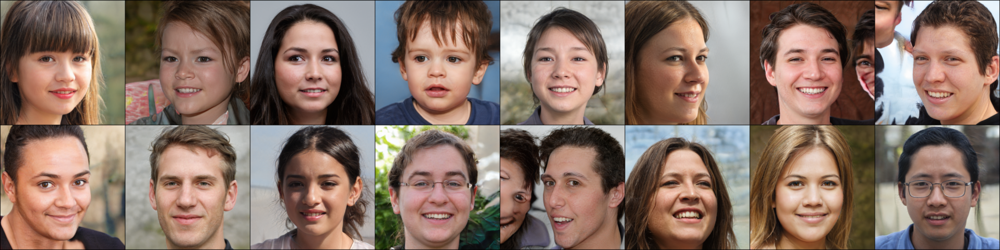

In [ ]:
# Set all ages to image 0 age
modified_latent_w = source_latent_w.clone()
age_w_latents = controller.get_group_w_latent(modified_latent_w, group='age')
age0_w_latent = age_w_latents[0]
modified_latent_w = controller.insert_group_w_latent(modified_latent_w, age0_w_latent, group='age')
image_tensors, _, _ = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

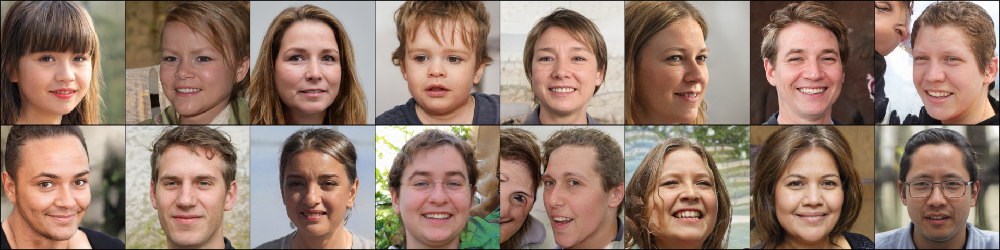

In [ ]:
# Set all hair colors to image 0 hair color
modified_latent_w = source_latent_w.clone()
hair_w_latents = controller.get_group_w_latent(modified_latent_w, group='hair')
hair0_w_latent = hair_w_latents[0]
modified_latent_w = controller.insert_group_w_latent(modified_latent_w, hair0_w_latent, group='hair')
image_tensors, _, _ = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

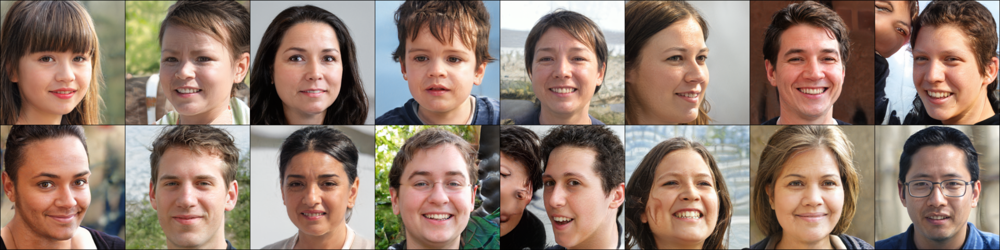

In [ ]:
# Set all illuminations to image 0 illumination
modified_latent_w = source_latent_w.clone()
illumination_w_latents = controller.get_group_w_latent(modified_latent_w, group='gamma')
illumination0_w_latent = illumination_w_latents[0]
modified_latent_w = controller.insert_group_w_latent(modified_latent_w, illumination0_w_latent, group='gamma')
image_tensors, _, _ = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)

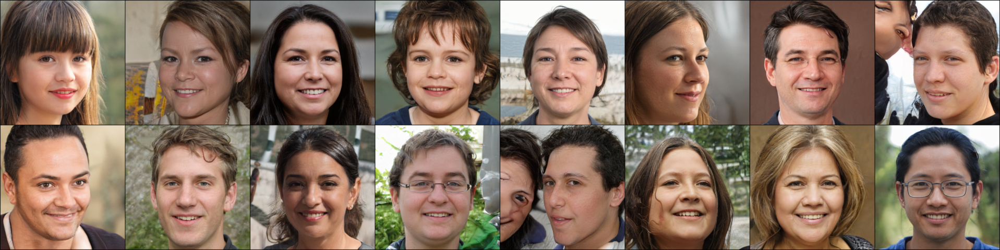

In [ ]:
# Set all expressions to image 0 expression
modified_latent_w = source_latent_w.clone()
expression_w_latents = controller.get_group_w_latent(modified_latent_w, group='expression')
expression0_w_latent = expression_w_latents[0]
modified_latent_w = controller.insert_group_w_latent(modified_latent_w, expression0_w_latent, group='expression')
image_tensors, _, _ = controller.gen_batch_by_controls(latent=modified_latent_w, input_is_latent=True)
controller.make_resized_grid_image(image_tensors, resize=resize, nrow=8)